# โจทย์ Black Friday Dataset

ให้พิจารณาชุดข้อมูล BlackFriday_train.csv ซึ่งสามารถศึกษาข้อมูลทั่วไปของชุดข้อมูลได้ที่
https://www.kaggle.com/sdolezel/black-friday#train.csv
โดยชุดข้อมูลดังกล่าวเก็บข้อมูลบันทึกรายการซื้อสินค้าของผู้คนในเทศกาล Black Friday ซึ่งแต่ละ record (row)
แทนหนึ่ง transaction ของการซื้อสินค้า ซึ่งประกอบด้วยตัวแปรดังต่อไปนี้

User_ID: รหัสผู้ใช้ที่ซื้อสินค้า transaction ดังกล่าว

Product_ID: รหัสสินค้าที่ซื้อ

Gender: เพศของผู้ใช้

Age: ช่วงอายุของผู้ใช้

Occupation: หมายเลขอาชีพของผู้ใช้ (ชุดข้อมูลไม่ระบุชื่ออาชีพ)

City_Category: กลุ่มประเภทของเมือง

Stay_In_Current_City_Years: จำนวนปีที่ผู้ใช้อาศัยอยู่ในเมืองปัจจุบัน

Marital_Status: สถานะการแต่งงาน

Product_Category_1: หมายเลขของสินค้าสำหรับระบุในสินค้ากลุ่มประเภท 1

Product_Category_2: หมายเลขของสินค้าสำหรับระบุในสินค้ากลุ่มประเภท 2

Product_Category_3: หมายเลขของสินค้าสำหรับระบุในสินค้ากลุ่มประเภท 3

Purchase: ปริมาณค่าใช้จ่ายสำหรับสินค้า

# ให้เขียน Python Sript ผ่าน Google Colab หรือ Ipython Notebook เพื่อวิเคราะห์และตอบคำถามต่อไปนี้

##1 ใน dataset ดังกล่าว เก็บรายการใช้จ่ายของ User เป็นจำนวนทั้งหมดกี่คน?

In [1]:
#solutions
from google.colab import files

files.upload()

Saving BlackFriday_train.csv to BlackFriday_train.csv


{'BlackFriday_train.csv': b'User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3,Purchase\r\n1000001,P00069042,F,0-17,10,A,2,0,3,,,8370\r\n1000001,P00248942,F,0-17,10,A,2,0,1,6,14,15200\r\n1000001,P00087842,F,0-17,10,A,2,0,12,,,1422\r\n1000001,P00085442,F,0-17,10,A,2,0,12,14,,1057\r\n1000002,P00285442,M,55+,16,C,4+,0,8,,,7969\r\n1000003,P00193542,M,26-35,15,A,3,0,1,2,,15227\r\n1000004,P00184942,M,46-50,7,B,2,1,1,8,17,19215\r\n1000004,P00346142,M,46-50,7,B,2,1,1,15,,15854\r\n1000004,P0097242,M,46-50,7,B,2,1,1,16,,15686\r\n1000005,P00274942,M,26-35,20,A,1,1,8,,,7871\r\n1000005,P00251242,M,26-35,20,A,1,1,5,11,,5254\r\n1000005,P00014542,M,26-35,20,A,1,1,8,,,3957\r\n1000005,P00031342,M,26-35,20,A,1,1,8,,,6073\r\n1000005,P00145042,M,26-35,20,A,1,1,1,2,5,15665\r\n1000006,P00231342,F,51-55,9,A,1,0,5,8,14,5378\r\n1000006,P00190242,F,51-55,9,A,1,0,4,5,,2079\r\n1000006,P0096642,F,51-55,9,A,1,0,2,3

In [2]:
import pandas as pd

df = pd.read_csv('BlackFriday_train.csv', sep=',')

In [3]:
print('ใน dataset เก็บรายการใช้จ่ายของ User เป็นจำนวน :', len(df.User_ID.unique()), 'คน')

ใน dataset เก็บรายการใช้จ่ายของ User เป็นจำนวน : 5891 คน


##2.1 ผู้ที่มาซื้อเป็นเพศชาย (M) ทั้งหมดกี่คน และเป็นเพศหญิง (F) ทั้งหมดกี่คน?

In [4]:
#solutions
check = df[['User_ID', 'Gender']]
check = check.drop_duplicates('User_ID', keep='first', ignore_index=True)
check['count'] = 1
gender = check.groupby('Gender')[['count']].sum()

print('ผู้ซื้อเพศชาย และเพศหญิงมีจำนวน')
gender

ผู้ซื้อเพศชาย และเพศหญิงมีจำนวน


,count
Gender,
F,1666
M,4225


##2.2 ผู้ที่มาซื้อส่วนใหญ่เป็นเพศชายหรือหญิง?

In [5]:
#solutions

print('ผู้ซื้อส่วนใหญ่ เป็นเพศ :', gender.index.max())

ผู้ซื้อส่วนใหญ่ เป็นเพศ : M


##3 เมื่อพิจารณาเฉพาะผู้ซื้อที่เป็นเพศหญิง ค่าเฉลี่ยของการใช้จ่ายรวม (Sum of Purchase) ต่อผู้ซื้อหนึ่งคนเป็นจำนวนเท่าไร?

In [6]:
gender.reset_index(inplace=True)

In [7]:
#solutions

sales = df[['User_ID', 'Gender', 'Purchase']]
sales = sales.groupby('Gender')[['Purchase']].agg('sum').reset_index()

sales = sales.merge(gender, how='inner', left_on='Gender', right_on='Gender')
sales['avg_purchase'] = sales.apply(lambda x : x['Purchase'] / x['count'], axis=1)


for row in sales.iterrows():
    if row[1]['Gender'] == 'F':
        print('ค่าเฉลี่ยของการใช้จ่ายรวมของผู้ซื้อเพศหญิง : %.2f' %row[1]['avg_purchase'])

ค่าเฉลี่ยของการใช้จ่ายรวมของผู้ซื้อเพศหญิง : 712024.39


##4 เราต้องการพิจารณาเป็นราย transaction ว่าสินค้าแต่ละหมายเลขในตัวแปร Product_Category_1
มีอัตราส่วนการซื้อเป็นอย่างไร

###4.1พล็อตกราฟแท่ง (column chart) แสดงปริมาณการซื้อของทุกหมายเลขสินค้าในตัวแปร Product_Category_1
(ให้นับปริมาณตามจำนวน transaction โดยไม่ต้องดูจาก Purchase)

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


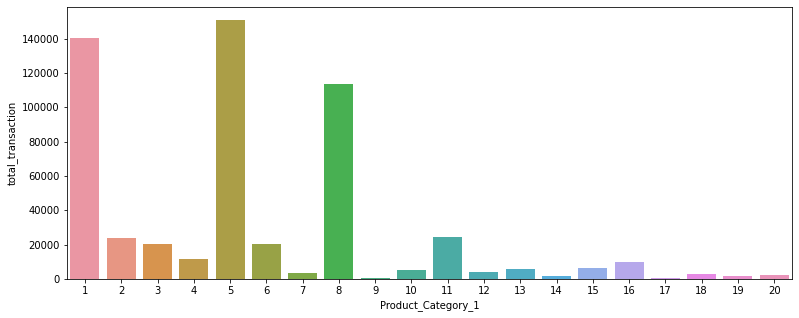

In [8]:
#solutions
from collections import Counter
import matplotlib.pyplot as plt
import seaborn as sns

p1 = []

for row in df['Product_Category_1']:
    p1.append(row)

p1_plot = pd.DataFrame.from_dict(dict(Counter(p1)), orient='index').reset_index()
p1_plot.rename(columns={'index' : 'Product_Category_1', 0 : 'total_transaction'}, inplace=True)

plt.figure(figsize=(13,5))
sns.barplot(x=p1_plot['Product_Category_1'], y=p1_plot['total_transaction'])

###4.2ให้ระบุหมายเลขสินค้าที่มีอัตราส่วนการซื้อมากที่สุด 3 ลำดับแรก

In [9]:
#solutions
p1_plot['avg_transaction'] = p1_plot.apply(lambda x : x['total_transaction'] / (p1_plot['total_transaction'].sum()) * 100, axis=1)

p3 = p1_plot.nlargest(3, 'avg_transaction')

print('หมายเลขสินค้าที่มีอัตราส่วนการซื้อมากที่สุด 3 อันดับ')
for row in p3.iterrows():
    print('>> %.0f' % row[1]['Product_Category_1'])

หมายเลขสินค้าที่มีอัตราส่วนการซื้อมากที่สุด 3 อันดับ
>> 5
>> 1
>> 8


##5 จากข้อ 4.2 ปริมาณการซื้อสินค้าทั้ง 3 อันดับแรกรวมกัน
คิดเป็นอัตราส่วนกี่เปอร์เซ็นต์ของปริมาณการซื้อสินค้าทั้งหมด

In [10]:
#solutions

print('ปริมาณการซื้อสินค้าทั้ง 3 อันดับแรกรวมกันคิดเป็น %.2f' % p3['avg_transaction'].sum(), '% ของปริมาณการซื้อสินค้าทั้งหมด')

ปริมาณการซื้อสินค้าทั้ง 3 อันดับแรกรวมกันคิดเป็น 73.67 % ของปริมาณการซื้อสินค้าทั้งหมด


##6 เราต้องการรู้ว่าตัวแปร Purchase มีความสัมพันธ์กับตัวแปร Age และ
Stay_In_Current_City_Years มากน้อยแค่ไหน เช่น อายุเยอะขึ้น จะใช้จ่ายเยอะขึ้นหรือเปล่า
หรือคนที่อาศัยอยู่ในเมืองปัจจุบันมานาน จะใช้จ่ายเยอะกว่า?
โดยที่ให้พิจารณาเป็นราย transaction (ไม่ต้องดูเป็นรายบุคคล)

###6.1 ให้ใช้ฟังก์ชัน pandas.DataFrame.corr() เพื่อพล็อตตาราง correlation matrix ระหว่าง 3 ตัวแปร ได้แก่ Age,
Stay_In_Current_City_Years, และ Purchase

In [13]:
#solutions

cor = df[['Age', 'Stay_In_Current_City_Years', 'Purchase']]
cor[['c_Age']] = cor[['Age']].apply(lambda x:pd.Categorical(x).codes)
cor[['c_Years']] = cor[['Stay_In_Current_City_Years']].apply(lambda x:pd.Categorical(x).codes)


cor.corr()

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:2963: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


,Purchase,c_Age,c_Years
Purchase,1.000000,0.015839,0.005422
c_Age,0.015839,1.000000,-0.004712
c_Years,0.005422,-0.004712,1.000000


###6.2 พิจารณาค่าในตาราง แล้วตอบว่า Purchase มีความสัมพันธ์เชิงบวกกับตัวแปรใดมากกว่ากัน ระหว่าง Age และ Stay_In_Current_City_Years

In [28]:
#solutions
print('Purchase มีความสัมพันธ์เชิงบวกกับตัวแปร Age มากกว่า')

Purchase มีความสัมพันธ์เชิงบวกกับตัวแปร Age มากกว่า
